# Singapore Live Traffic Monitoring System
**By Sarang Deb Saha**

This project aims to classify and count different types of vehicles from traffic camera images using a YOLOv8 object detection model. The project follows a systematic approach, starting from fetching traffic camera images, training a vehicle classification model, running inferences, and finally visualizing the results. Below is a detailed breakdown of the key steps and decisions involved:

**Step 1: Fetching Traffic Camera Images**

We begin by fetching real-time traffic camera images from the Singapore Land Transport Authority's Tampines Expressway (TPE) traffic camera page [link](https://https://onemotoring.lta.gov.sg/content/onemotoring/home/driving/traffic_information/traffic-cameras/tpe.html#trafficCameras). It was noticed that these images update approximately every 3 minutes, so we implemented a script to capture and store them periodically.

The HTTP request to the webpage checks the response status code to ensure successful access (expected codes 200-299). Once confirmed, the images are parsed and their URLs extracted using BeautifulSoup. We store the images locally under the traffic_images directory for further processing.

We are using previously fetched data from our drive here, but there’s an option to enable continuous fetching for a 30-minute period (commented in the script to save time). This feature can be activated when real-time monitoring is needed.

**Step 2: Dataset Selection and Model Choice**

For the vehicle classification task, we opted to use the YOLOv8 object detection model, known for its speed and accuracy in real-time detection scenarios. We chose this model to detect various vehicle types in traffic camera images.

For training the model, we searched for an appropriate dataset that has images from a aerial angle and quality to our fetched images (Traffic cam images) and found the Vehicle Detection 8 Classes dataset on Kaggle, which contains 8219 images across 8 vehicle classes: ["Auto", "Bus", "Car", "LCV", "Motorcycle", "Truck", "Tractor", "Multi-Axle"]. The dataset provides ample variety and balance across vehicle categories, making it ideal for training a robust detection model. This dataset has Indian context to it and I know we might not detect many autos or tractors on Singapore highways, also that Indian trucks are aesthetically different compared to Singapore trucks. But this is the best dataset I found for out task.

**Step 3: Training the YOLOv8 Model**

The dataset was split into an 80-20 ratio for training and validation sets. A custom YOLOv8 YAML configuration file was created to define the dataset and the class labels. The model was trained using the following hyperparameters:



* Epochs: 50
* Image size: 640x640
* Optimizer: AdamW
* Initial learning rate: 0.0001
* Learning rate final: 0.1
* Dropout: 0.1
* Batch size: 32
* Patience: 10 (for early stopping)
* Random seed: 0



The training was conducted in a Google Colab environment utilizing a T4 GPU to accelerate computation. After training, we evaluated the model using common object detection metrics (Precision, Recall, mAP) for each vehicle class.

Evaluation Metrics:

* mAP@50: 0.828 (mean Average Precision)
* mAP@50-95: 0.581
* Precision: 0.8277
* Recall: 0.8277

Class-wise performance varied slightly, with Car and Tractor showing the highest precision and recall values, while LCV and Motorcycle exhibited slightly lower performance, particularly in mAP.

**Step 4: Running Inference**

Once the model training was completed, we used the best.pt model checkpoint to run inference on the entire directory of previously fetched traffic images. The model predicted the class and bounding boxes for the vehicles detected in each image, logging the counts for each vehicle type. We also calculated and displayed the total inference time for processing the entire image directory, providing insight into the model's efficiency.

**Step 5: Visualization of Vehicle Distribution**

Finally, we visualized the vehicle distribution using three key plots-

* Bar Plot: Shows the absolute count of each vehicle type detected. This provides a clear comparison of the volume of different vehicles in the dataset.
* Pie Chart: Visualizes the proportional representation of each vehicle type in the dataset, giving a sense of how dominant each class is relative to others.
* Line Plot: Displays the trend of vehicle counts across classes, helping to spot any patterns or outliers in the dataset.


**Addressing key topics:**

1. Handling Data at Scale:

  As traffic grows or more streams are added, the system must handle large volumes of image data efficiently. Here’s how to manage this:

  * Parallel Processing: Implement multi-threading or asynchronous processing to fetch and process multiple streams concurrently.
  Distributed Storage: Use a distributed file system like HDFS or cloud storage (AWS S3, GCP Storage) to handle large datasets.
  * Batch Processing: Instead of real-time processing of each image, batch process the images at set intervals (e.g., every 3 minutes) to reduce overhead.
  * Edge Processing: For even larger scales, inference can be moved to the edge devices (e.g., cameras with integrated compute units) for faster results.

2. Making Inference Faster:

* Model Pruning: Trim unnecessary weights from the model, making it smaller and faster without losing much accuracy.
* Quantization: Convert model weights to lower precision (e.g., 16-bit or 8-bit), reducing computation time.
* Hardware Acceleration: Use GPU or TPU for faster processing. In cloud setups, scale the compute power to process more streams in parallel.
* Batch Inference: Instead of running inference on individual images, batch multiple images together, reducing the overhead from frequent model loading.
* We can also leverage ONNX and TensorRT for optimized performance on different hardware (this would automatically ensure Model Pruning and Quantization)

3. Taking This to Production:

* Scalability: Managing and processing traffic streams across multiple locations requires a scalable infrastructure with robust load balancing.
* Latency: Real-time inference requires low-latency systems, achievable by using edge computing or faster cloud services.
* Maintenance: Keeping the model updated as traffic conditions or vehicle types change is crucial. Implementing a continuous training pipeline (CI/CD for ML) will help.
* Monitoring: Constantly monitor model performance with real-time dashboards to detect issues or drifts in model predictions.
* Data Privacy: Ensuring compliance with local data privacy laws when handling real-time image data, especially when processing in the cloud.

4. Evaluation and Improvement Ideas:

* Class Imbalance: Certain vehicle classes (e.g., tractors) have fewer instances, which might affect model generalization. Data augmentation or oversampling could help.
* False Positives: Improving precision to reduce false detections, particularly for similar-looking classes (e.g., trucks vs. multi-axle vehicles).
* Longer Training: Increase training epochs or fine-tune the model with additional datasets to improve recall for rarer classes.
* Post-Processing: Use non-maximum suppression (NMS) to reduce overlapping bounding boxes and improve the accuracy of class detection.

5. Potential Use-Cases:

* Traffic Management: City planners can use this model to monitor and regulate traffic flow in real-time, optimizing signal timings or redirecting traffic during congestions.
* Toll Booths: Automated vehicle classification can be implemented in toll systems to identify vehicles and charge them appropriately.
* Smart Parking: Detect available parking spaces by identifying the absence of vehicles in designated spots.
* Accident Detection: Anomaly detection can be added to the pipeline to alert authorities when traffic patterns deviate drastically, indicating an accident or breakdown.
* Environmental Analysis: Monitor pollution by classifying and counting different types of vehicles and correlating the data with emissions levels.

In [7]:
!pip install gdown

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com



[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [1]:
import requests
from bs4 import BeautifulSoup
import time
import os

In [2]:
os.makedirs('traffic_images', exist_ok=True)

url = 'https://onemotoring.lta.gov.sg/content/onemotoring/home/driving/traffic_information/traffic-cameras/tpe.html#trafficCameras'

In [3]:
response = requests.get(url)
print(response.status_code)

200


In [4]:
soup = BeautifulSoup(response.content, 'html.parser')
img_tags = soup.find_all('img')
for idx, img in enumerate(img_tags):
    print(f"Index: {idx}, Image URL: {img.get('src')}")

Index: 0, Image URL: /content/dam/onemotoring/img/general/primary-logo.jpg
Index: 1, Image URL: /etc/designs/onemotoring/images/singpass.png
Index: 2, Image URL: /content/dam/onemotoring/img/general/primary-logo.jpg
Index: 3, Image URL: /content/dam/onemotoring/img/traffic_cam/map.jpg
Index: 4, Image URL: //datamall.lta.gov.sg/trafficsmart/images/7795_1928_20241113193015_dadb5e.jpg
Index: 5, Image URL: //datamall.lta.gov.sg/trafficsmart/images/7796_1929_20241113193015_a41e48.jpg
Index: 6, Image URL: //datamall.lta.gov.sg/trafficsmart/images/7798_1929_20241113193016_136c99.jpg
Index: 7, Image URL: //datamall.lta.gov.sg/trafficsmart/images/7797_1929_20241113193015_9a51b5.jpg
Index: 8, Image URL: //datamall.lta.gov.sg/trafficsmart/images/7793_1929_20241113193015_2e8c25.jpg
Index: 9, Image URL: //datamall.lta.gov.sg/trafficsmart/images/7794_1929_20241113193015_fcea02.jpg
Index: 10, Image URL: //datamall.lta.gov.sg/trafficsmart/images/7791_1929_20241113193015_e78d73.jpg


In [5]:
def fetch_images():
    response = requests.get(url)
    soup = BeautifulSoup(response.content, 'html.parser')
    img_tags = soup.find_all('img')
    for idx, img in enumerate(img_tags):
        img_url = img.get('src')
        if img_url and 'datamall.lta.gov.sg/trafficsmart/images/' in img_url:
            full_img_url = "https:" + img_url
            img_data = requests.get(full_img_url).content
            print(full_img_url)
            timestamp = time.strftime("%Y%m%d-%H%M%S")

            img_filename = f"traffic_images/cam_{idx-3}_{timestamp}.jpg"
            with open(img_filename, 'wb') as img_file:
                img_file.write(img_data)
                print(f"Saved {img_filename}")

Uncomment this if you wish to download a fresh (real-time) batch of image stream

**Caution: This block will execute for the next 30 mins.**

For now, we'll just use a previously fetched batch of images from my drive

In [6]:
# for _ in range(10):
#     fetch_images()
#     time.sleep(180)

In [8]:
import gdown
file_id = '1QXYKz1CDYtu3s5Aw3Ysy6CuF2kncmRRf'
output = 'traffic_images.zip'
gdown.download(f'https://drive.google.com/uc?id={file_id}', output, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1QXYKz1CDYtu3s5Aw3Ysy6CuF2kncmRRf
To: d:\New folder (2)\traffic_images.zip
100%|██████████| 16.1M/16.1M [00:06<00:00, 2.40MB/s]


'traffic_images.zip'

In [9]:
import zipfile
import os

current_dir = os.getcwd()
def unzip(zip_file_path, extract_to_dir):
    if os.path.exists(zip_file_path):
        with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
            zip_ref.extractall(extract_to_dir)
        print(f"File extracted to: {extract_to_dir}")
    else:
        print(f"Error: {zip_file_path} does not exist")

zip_file = 'traffic_images.zip'
output_directory = current_dir

unzip(zip_file, output_directory)

File extracted to: d:\New folder (2)


In [10]:
!pip install ultralytics

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com



[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [11]:
file_id = '1jsh6k7psbbQ7oF1G1P1-o0GaLQujQOsX'
output = 'best.pt'
gdown.download(f'https://drive.google.com/uc?id={file_id}', output, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1jsh6k7psbbQ7oF1G1P1-o0GaLQujQOsX
To: d:\New folder (2)\best.pt
100%|██████████| 6.25M/6.25M [00:01<00:00, 6.25MB/s]


'best.pt'

In [12]:
from ultralytics import YOLO
model = YOLO(os.path.join(current_dir, 'best.pt'))

Running inference on: cam_1_20241021-133800.jpg

0: 384x640 2 Cars, 67.0ms
Speed: 16.0ms preprocess, 67.0ms inference, 216.3ms postprocess per image at shape (1, 3, 384, 640)


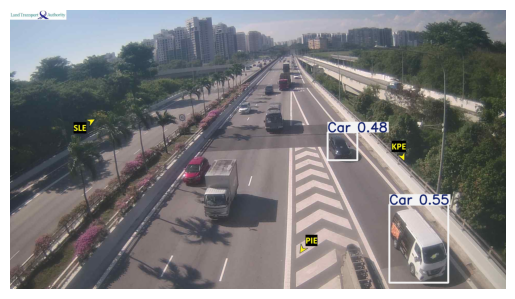

Running inference on: cam_1_20241021-134104.jpg

0: 384x640 1 Car, 24.0ms
Speed: 0.0ms preprocess, 24.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


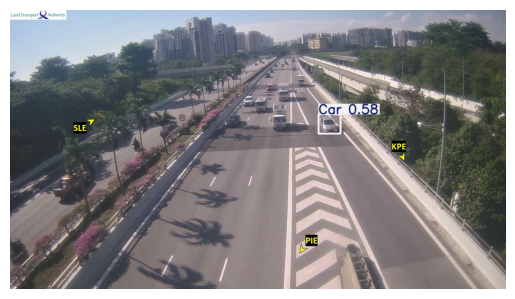

Running inference on: cam_1_20241021-134408.jpg

0: 384x640 1 Multi-Axle, 13.5ms
Speed: 2.7ms preprocess, 13.5ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


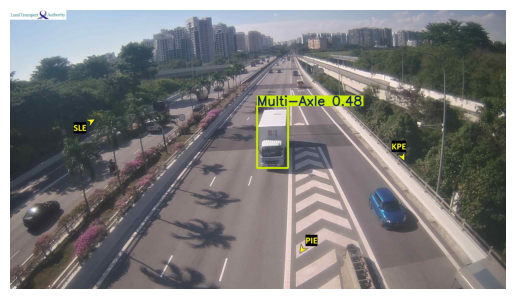

Running inference on: cam_1_20241021-134711.jpg

0: 384x640 (no detections), 8.0ms
Speed: 8.0ms preprocess, 8.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


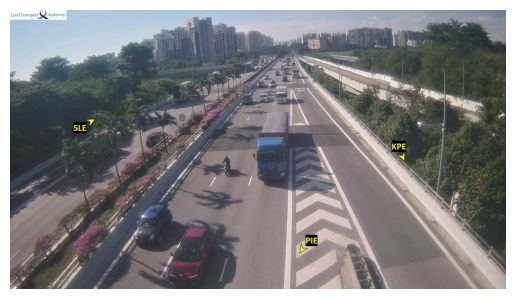

Running inference on: cam_1_20241021-135015.jpg

0: 384x640 (no detections), 8.0ms
Speed: 0.0ms preprocess, 8.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


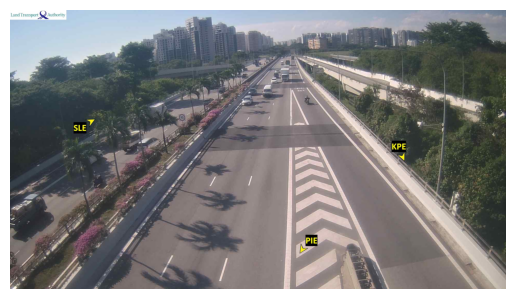

Running inference on: cam_1_20241021-135319.jpg

0: 384x640 1 Car, 16.2ms
Speed: 8.0ms preprocess, 16.2ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


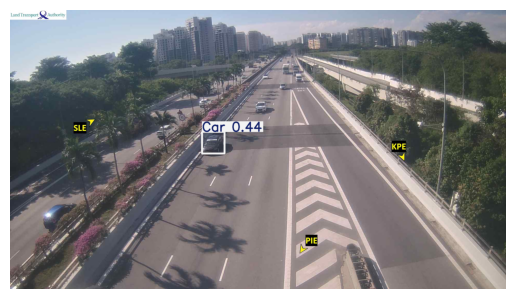

Running inference on: cam_1_20241021-135622.jpg

0: 384x640 (no detections), 8.0ms
Speed: 0.0ms preprocess, 8.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


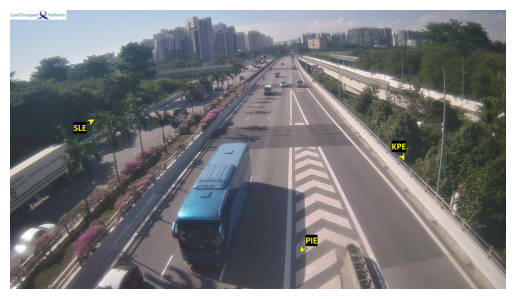

Running inference on: cam_1_20241021-135927.jpg

0: 384x640 2 Cars, 16.4ms
Speed: 2.8ms preprocess, 16.4ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


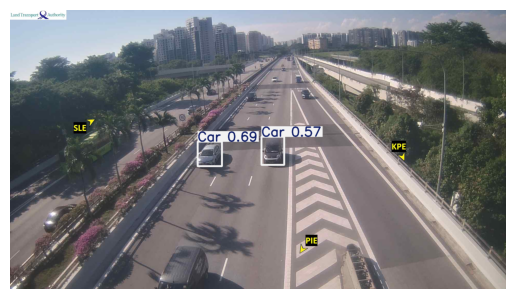

Running inference on: cam_1_20241021-140230.jpg

0: 384x640 2 Cars, 1 Multi-Axle, 8.0ms
Speed: 8.0ms preprocess, 8.0ms inference, 8.3ms postprocess per image at shape (1, 3, 384, 640)


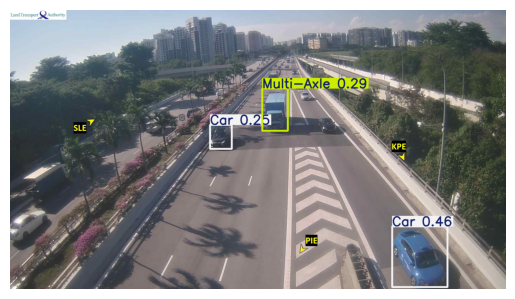

Running inference on: cam_1_20241021-140533.jpg

0: 384x640 2 Cars, 12.1ms
Speed: 3.3ms preprocess, 12.1ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


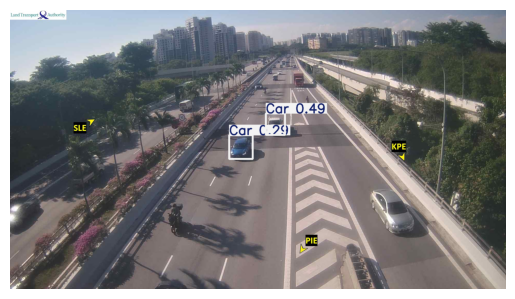

Running inference on: cam_2_20241021-133801.jpg

0: 384x640 3 Cars, 1 Multi-Axle, 16.0ms
Speed: 0.1ms preprocess, 16.0ms inference, 74.7ms postprocess per image at shape (1, 3, 384, 640)


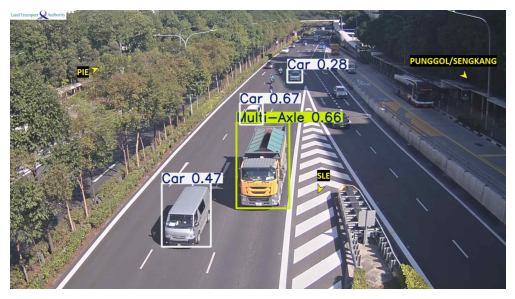

Running inference on: cam_2_20241021-134104.jpg

0: 384x640 3 Cars, 16.0ms
Speed: 0.0ms preprocess, 16.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


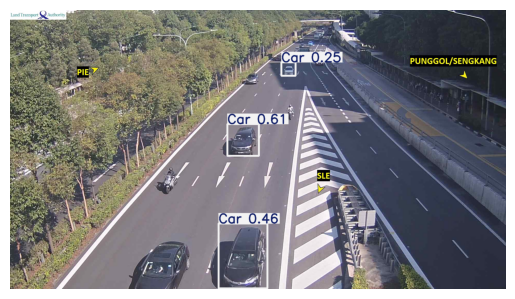

Running inference on: cam_2_20241021-134408.jpg

0: 384x640 3 Cars, 1 Motorcycle, 1 Multi-Axle, 16.0ms
Speed: 0.0ms preprocess, 16.0ms inference, 8.0ms postprocess per image at shape (1, 3, 384, 640)


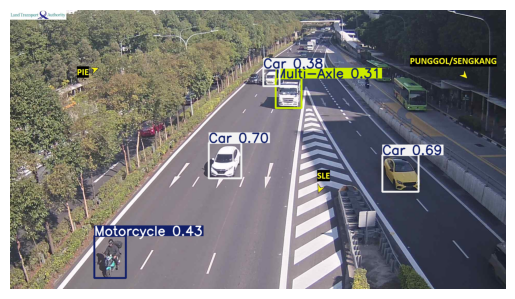

Running inference on: cam_2_20241021-134711.jpg

0: 384x640 2 Cars, 8.0ms
Speed: 8.0ms preprocess, 8.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


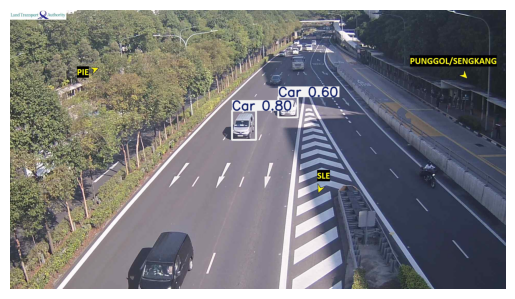

Running inference on: cam_2_20241021-135015.jpg

0: 384x640 2 Cars, 29.2ms
Speed: 8.3ms preprocess, 29.2ms inference, 8.0ms postprocess per image at shape (1, 3, 384, 640)


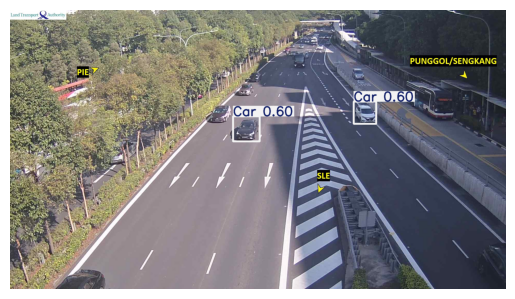

Running inference on: cam_2_20241021-135319.jpg

0: 384x640 3 Cars, 12.7ms
Speed: 5.5ms preprocess, 12.7ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


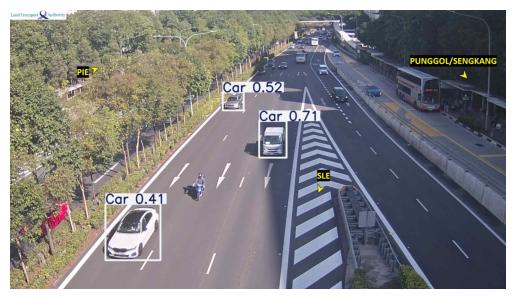

Running inference on: cam_2_20241021-135622.jpg

0: 384x640 8 Cars, 8.0ms
Speed: 8.0ms preprocess, 8.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


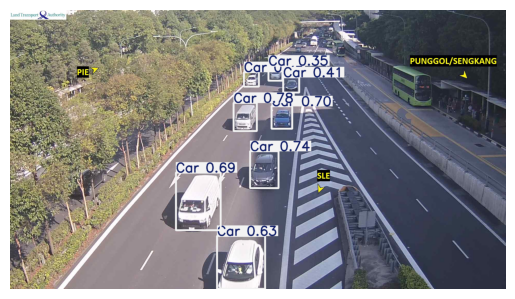

Running inference on: cam_2_20241021-135927.jpg

0: 384x640 5 Cars, 1 Motorcycle, 1 Multi-Axle, 0.0ms
Speed: 8.0ms preprocess, 0.0ms inference, 8.0ms postprocess per image at shape (1, 3, 384, 640)


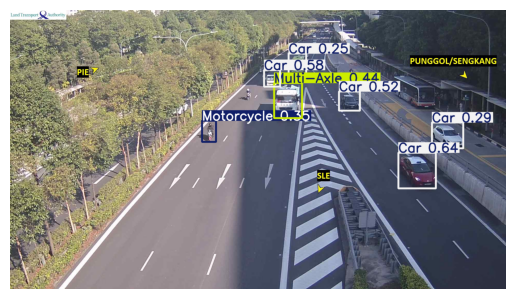

Running inference on: cam_2_20241021-140230.jpg

0: 384x640 2 Cars, 1 Multi-Axle, 12.1ms
Speed: 3.3ms preprocess, 12.1ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 640)


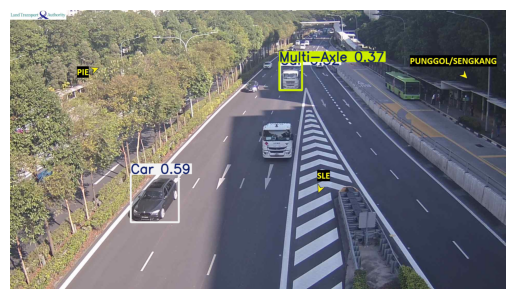

Running inference on: cam_2_20241021-140533.jpg

0: 384x640 2 Cars, 1 Motorcycle, 1 Multi-Axle, 16.0ms
Speed: 0.0ms preprocess, 16.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


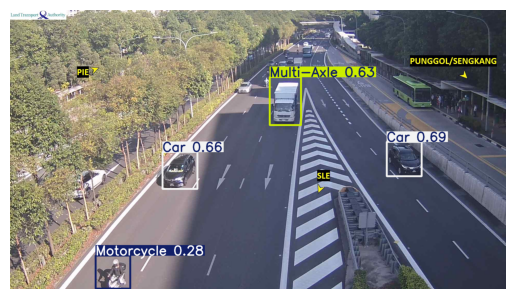

Running inference on: cam_3_20241021-133801.jpg

0: 384x640 2 Multi-Axles, 8.0ms
Speed: 6.6ms preprocess, 8.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


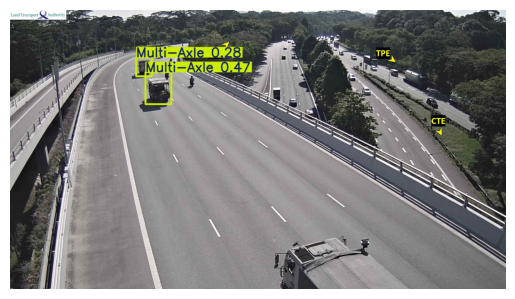

Running inference on: cam_3_20241021-134104.jpg

0: 384x640 2 Cars, 86.1ms
Speed: 0.0ms preprocess, 86.1ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


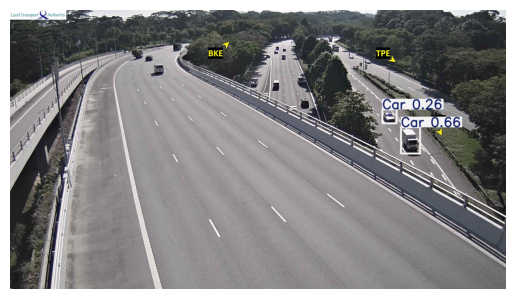

Running inference on: cam_3_20241021-134409.jpg

0: 384x640 1 Car, 1 Motorcycle, 1 Multi-Axle, 19.2ms
Speed: 4.6ms preprocess, 19.2ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 640)


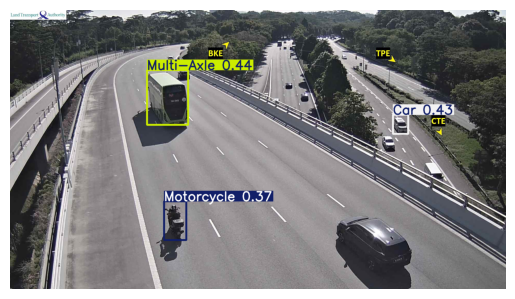

Running inference on: cam_3_20241021-134712.jpg

0: 384x640 4 Cars, 1 Motorcycle, 24.0ms
Speed: 3.2ms preprocess, 24.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


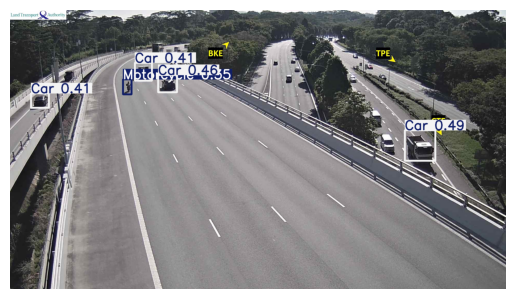

Running inference on: cam_3_20241021-135016.jpg

0: 384x640 2 Cars, 1 Multi-Axle, 8.0ms
Speed: 0.0ms preprocess, 8.0ms inference, 6.1ms postprocess per image at shape (1, 3, 384, 640)


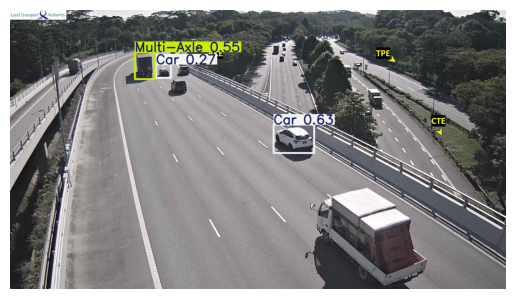

Running inference on: cam_3_20241021-135319.jpg

0: 384x640 1 Car, 1 Truck, 1 Multi-Axle, 24.0ms
Speed: 0.0ms preprocess, 24.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


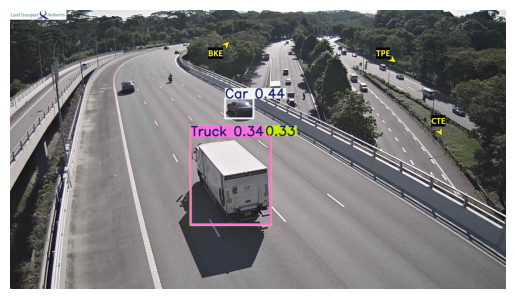

Running inference on: cam_3_20241021-135622.jpg

0: 384x640 1 Motorcycle, 8.7ms
Speed: 3.3ms preprocess, 8.7ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


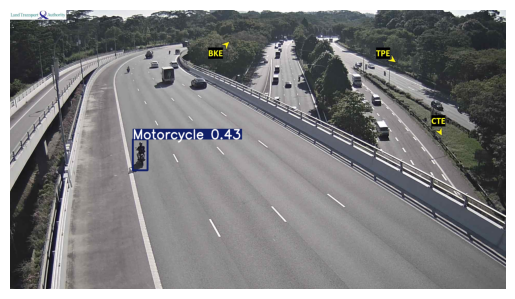

Running inference on: cam_3_20241021-135927.jpg

0: 384x640 1 Car, 1 Multi-Axle, 8.0ms
Speed: 0.0ms preprocess, 8.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


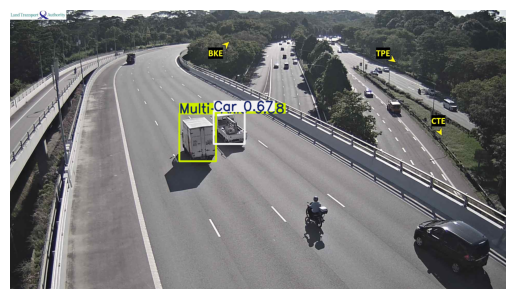

Running inference on: cam_3_20241021-140230.jpg

0: 384x640 1 Motorcycle, 146.0ms
Speed: 8.0ms preprocess, 146.0ms inference, 4.8ms postprocess per image at shape (1, 3, 384, 640)


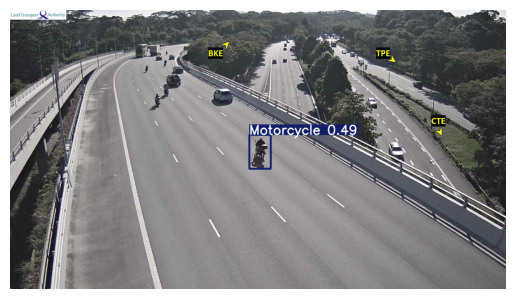

Running inference on: cam_3_20241021-140534.jpg

0: 384x640 1 Motorcycle, 16.0ms
Speed: 6.4ms preprocess, 16.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


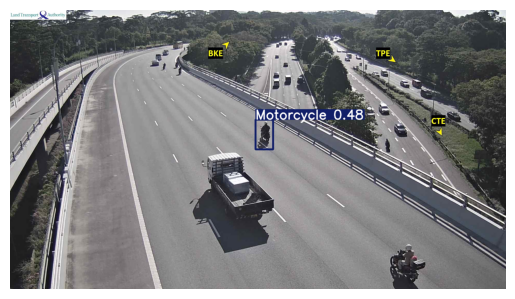

Running inference on: cam_4_20241021-133801.jpg

0: 384x640 5 Cars, 8.0ms
Speed: 8.0ms preprocess, 8.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


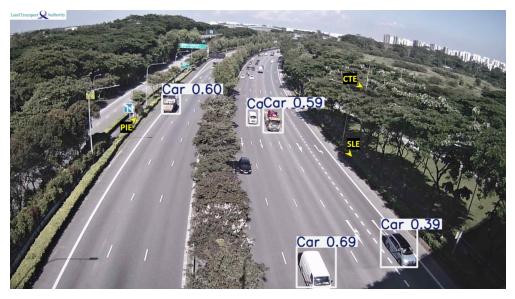

Running inference on: cam_4_20241021-134105.jpg

0: 384x640 1 Car, 7.3ms
Speed: 6.3ms preprocess, 7.3ms inference, 7.6ms postprocess per image at shape (1, 3, 384, 640)


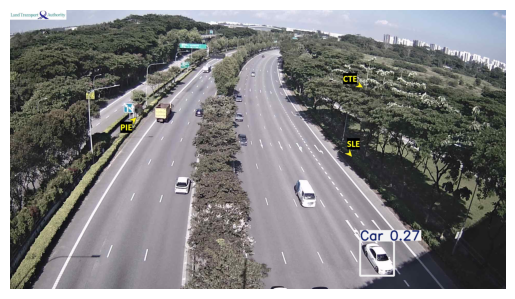

Running inference on: cam_4_20241021-134409.jpg

0: 384x640 5 Cars, 8.8ms
Speed: 0.0ms preprocess, 8.8ms inference, 7.9ms postprocess per image at shape (1, 3, 384, 640)


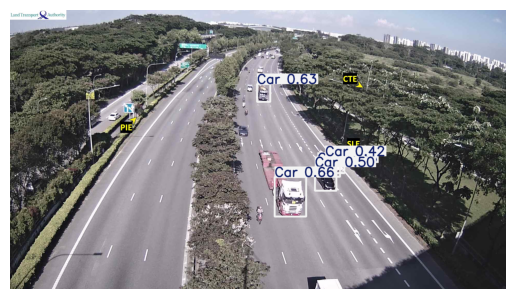

Running inference on: cam_4_20241021-134712.jpg

0: 384x640 3 Cars, 18.3ms
Speed: 0.0ms preprocess, 18.3ms inference, 8.0ms postprocess per image at shape (1, 3, 384, 640)


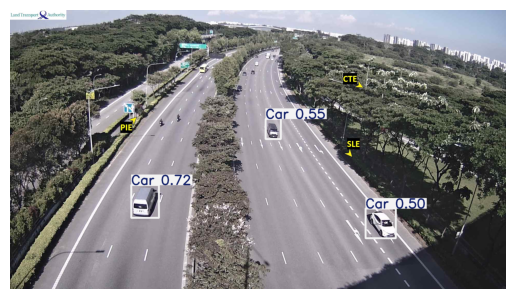

Running inference on: cam_4_20241021-135016.jpg

0: 384x640 2 Cars, 18.3ms
Speed: 0.0ms preprocess, 18.3ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


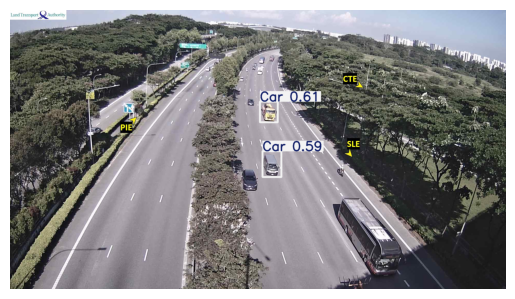

Running inference on: cam_4_20241021-135320.jpg

0: 384x640 1 Car, 8.2ms
Speed: 0.4ms preprocess, 8.2ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


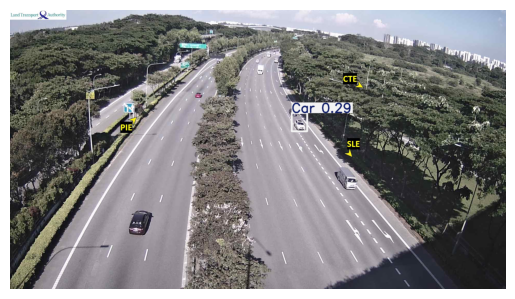

Running inference on: cam_4_20241021-135623.jpg

0: 384x640 2 Cars, 49.3ms
Speed: 0.0ms preprocess, 49.3ms inference, 16.0ms postprocess per image at shape (1, 3, 384, 640)


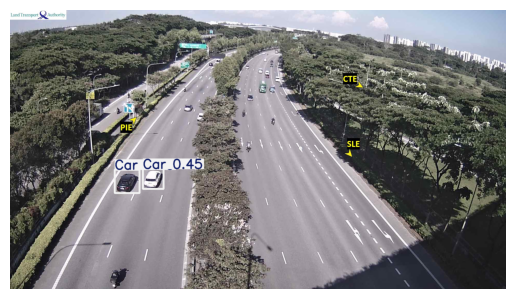

Running inference on: cam_4_20241021-135928.jpg

0: 384x640 2 Cars, 16.1ms
Speed: 0.0ms preprocess, 16.1ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


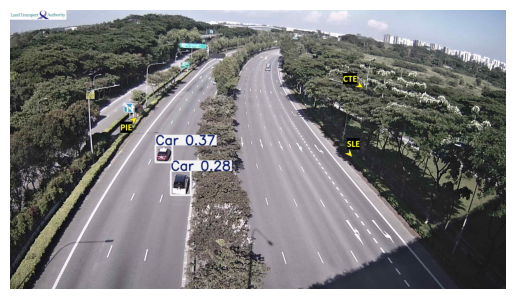

Running inference on: cam_4_20241021-140231.jpg

0: 384x640 9 Cars, 16.0ms
Speed: 8.0ms preprocess, 16.0ms inference, 8.0ms postprocess per image at shape (1, 3, 384, 640)


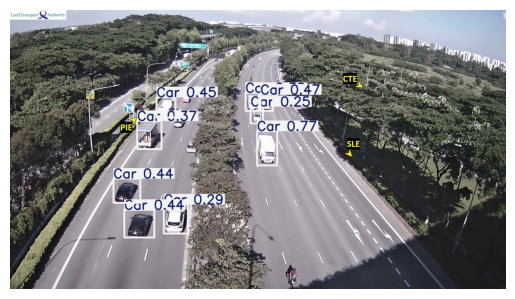

Running inference on: cam_4_20241021-140534.jpg

0: 384x640 3 Cars, 8.6ms
Speed: 0.0ms preprocess, 8.6ms inference, 8.0ms postprocess per image at shape (1, 3, 384, 640)


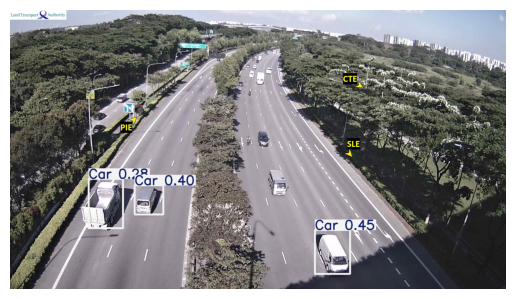

Running inference on: cam_5_20241021-133802.jpg

0: 384x640 1 Bus, 4 Cars, 16.0ms
Speed: 8.0ms preprocess, 16.0ms inference, 8.0ms postprocess per image at shape (1, 3, 384, 640)


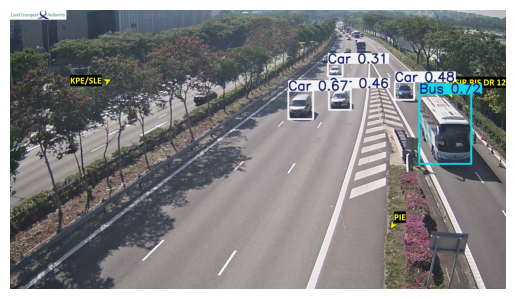

Running inference on: cam_5_20241021-134105.jpg

0: 384x640 2 Cars, 16.0ms
Speed: 8.0ms preprocess, 16.0ms inference, 8.0ms postprocess per image at shape (1, 3, 384, 640)


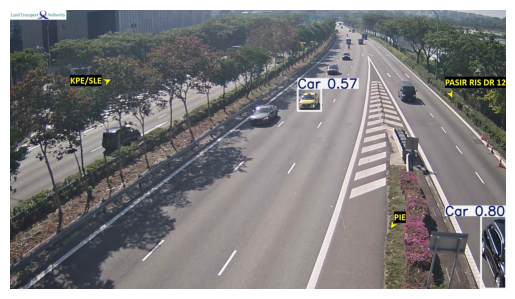

Running inference on: cam_5_20241021-134409.jpg

0: 384x640 1 Car, 24.0ms
Speed: 0.0ms preprocess, 24.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


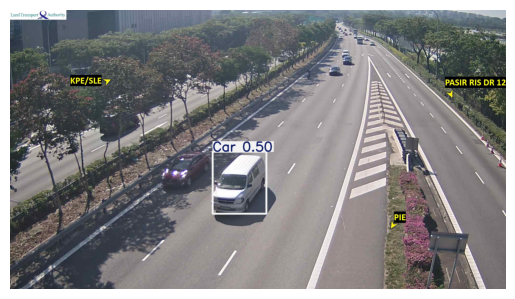

Running inference on: cam_5_20241021-134712.jpg

0: 384x640 1 Bus, 2 Cars, 40.0ms
Speed: 8.0ms preprocess, 40.0ms inference, 8.0ms postprocess per image at shape (1, 3, 384, 640)


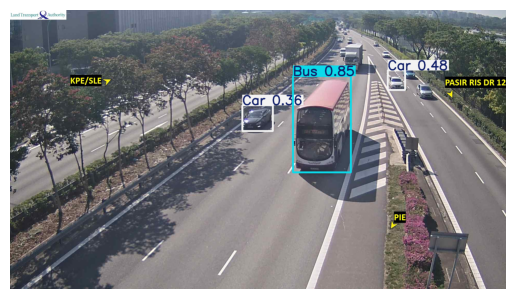

Running inference on: cam_5_20241021-135017.jpg

0: 384x640 2 Cars, 8.0ms
Speed: 16.4ms preprocess, 8.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


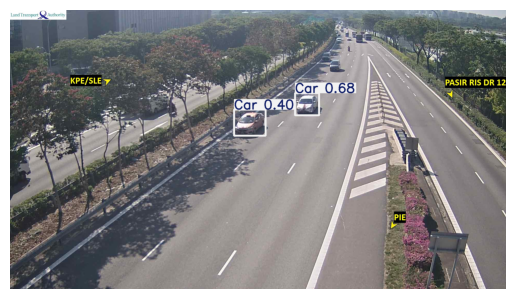

Running inference on: cam_5_20241021-135320.jpg

0: 384x640 1 Bus, 1 Car, 1 Multi-Axle, 21.3ms
Speed: 6.1ms preprocess, 21.3ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


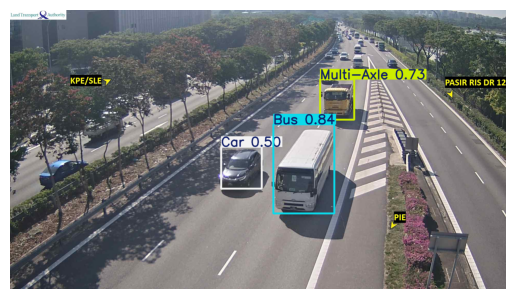

Running inference on: cam_5_20241021-135623.jpg

0: 384x640 (no detections), 10.3ms
Speed: 5.8ms preprocess, 10.3ms inference, 5.1ms postprocess per image at shape (1, 3, 384, 640)


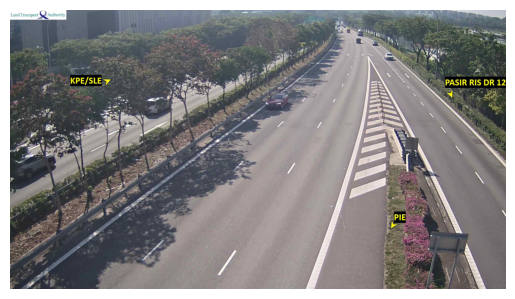

Running inference on: cam_5_20241021-135928.jpg

0: 384x640 1 Car, 53.3ms
Speed: 9.5ms preprocess, 53.3ms inference, 10.5ms postprocess per image at shape (1, 3, 384, 640)


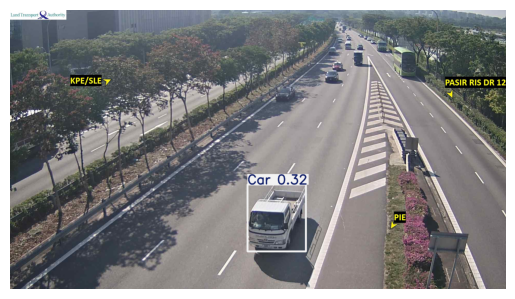

Running inference on: cam_5_20241021-140231.jpg

0: 384x640 1 Bus, 1 Car, 9.9ms
Speed: 5.9ms preprocess, 9.9ms inference, 8.3ms postprocess per image at shape (1, 3, 384, 640)


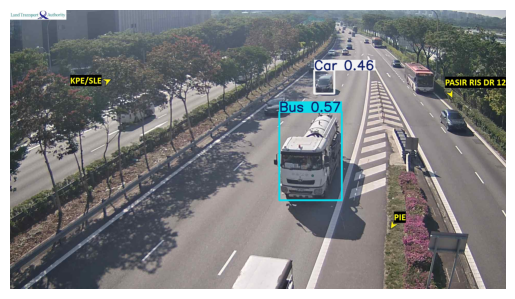

Running inference on: cam_5_20241021-140535.jpg

0: 384x640 1 Car, 7.1ms
Speed: 3.1ms preprocess, 7.1ms inference, 5.6ms postprocess per image at shape (1, 3, 384, 640)


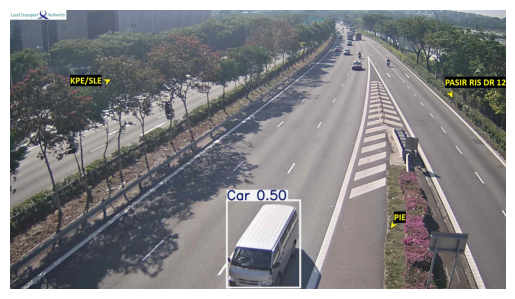

Running inference on: cam_6_20241021-133802.jpg

0: 384x640 (no detections), 6.6ms
Speed: 3.1ms preprocess, 6.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


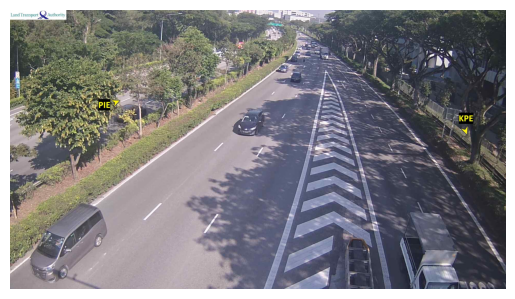

Running inference on: cam_6_20241021-134106.jpg

0: 384x640 1 Motorcycle, 20.6ms
Speed: 0.0ms preprocess, 20.6ms inference, 11.3ms postprocess per image at shape (1, 3, 384, 640)


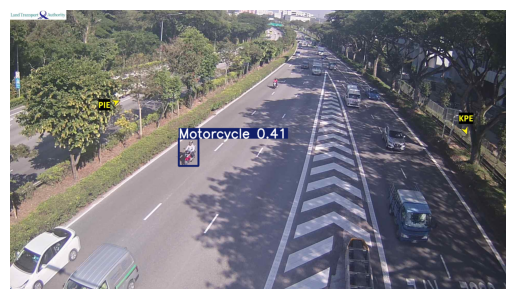

Running inference on: cam_6_20241021-134410.jpg

0: 384x640 1 Car, 10.8ms
Speed: 8.0ms preprocess, 10.8ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


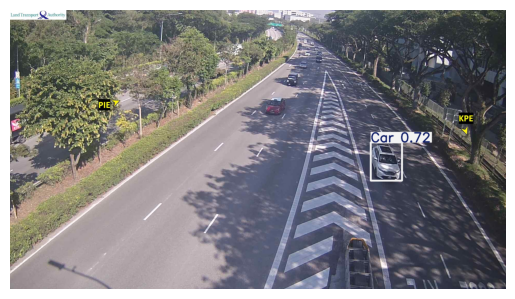

Running inference on: cam_6_20241021-134713.jpg

0: 384x640 2 Cars, 1 Truck, 8.0ms
Speed: 0.0ms preprocess, 8.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


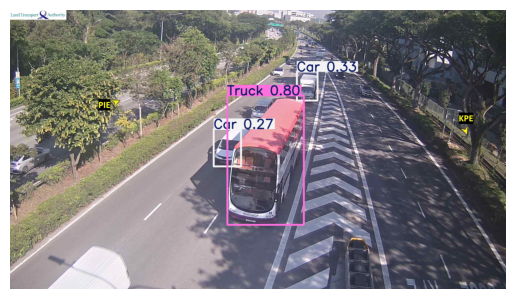

Running inference on: cam_6_20241021-135017.jpg

0: 384x640 1 Car, 16.9ms
Speed: 0.0ms preprocess, 16.9ms inference, 8.7ms postprocess per image at shape (1, 3, 384, 640)


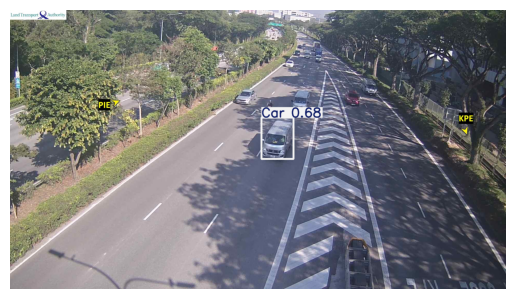

Running inference on: cam_6_20241021-135320.jpg

0: 384x640 1 Car, 1 Multi-Axle, 16.2ms
Speed: 8.0ms preprocess, 16.2ms inference, 7.2ms postprocess per image at shape (1, 3, 384, 640)


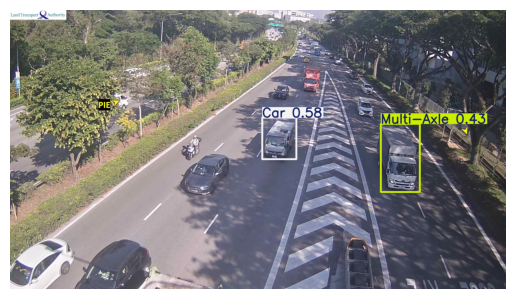

Running inference on: cam_6_20241021-135623.jpg

0: 384x640 1 Car, 9.5ms
Speed: 3.2ms preprocess, 9.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


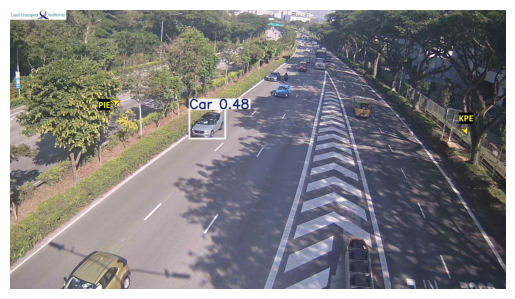

Running inference on: cam_6_20241021-135928.jpg

0: 384x640 1 Car, 84.1ms
Speed: 9.9ms preprocess, 84.1ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


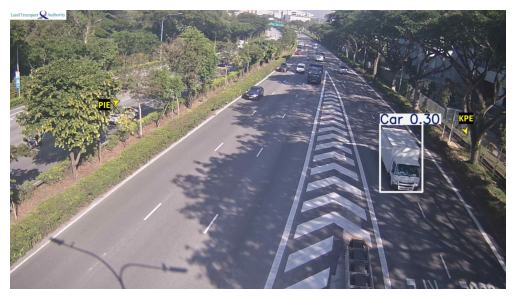

Running inference on: cam_6_20241021-140231.jpg

0: 384x640 1 Car, 8.0ms
Speed: 0.0ms preprocess, 8.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


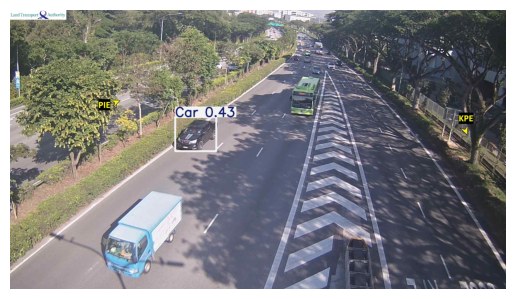

Running inference on: cam_6_20241021-140535.jpg

0: 384x640 1 Car, 1 Motorcycle, 21.7ms
Speed: 10.4ms preprocess, 21.7ms inference, 5.3ms postprocess per image at shape (1, 3, 384, 640)


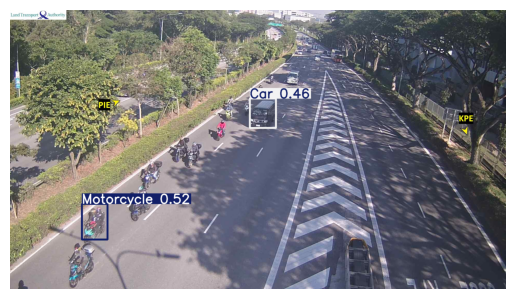

Running inference on: cam_7_20241021-133802.jpg

0: 384x640 1 Car, 11.8ms
Speed: 5.1ms preprocess, 11.8ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


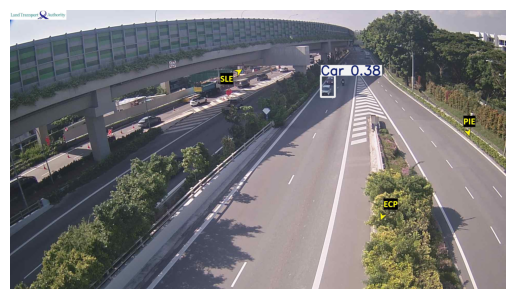

Running inference on: cam_7_20241021-134106.jpg

0: 384x640 (no detections), 8.0ms
Speed: 0.0ms preprocess, 8.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


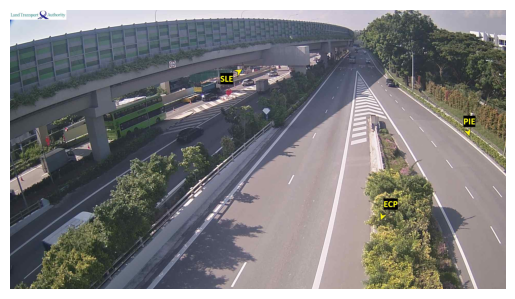

Running inference on: cam_7_20241021-134410.jpg

0: 384x640 1 Car, 9.7ms
Speed: 10.6ms preprocess, 9.7ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


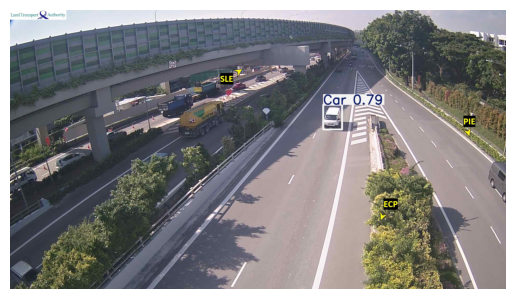

Running inference on: cam_7_20241021-134713.jpg

0: 384x640 2 Cars, 21.1ms
Speed: 0.0ms preprocess, 21.1ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


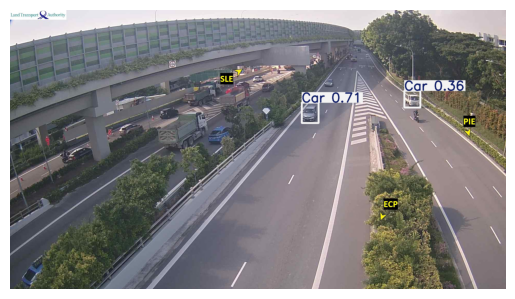

Running inference on: cam_7_20241021-135017.jpg

0: 384x640 1 Car, 7.0ms
Speed: 3.7ms preprocess, 7.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


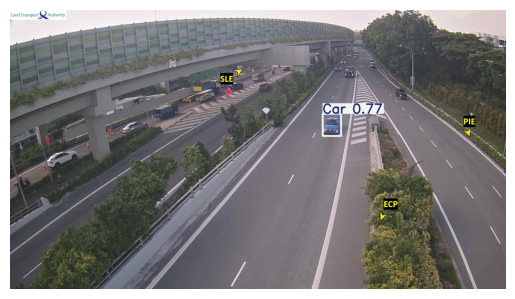

Running inference on: cam_7_20241021-135320.jpg

0: 384x640 (no detections), 12.9ms
Speed: 5.0ms preprocess, 12.9ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


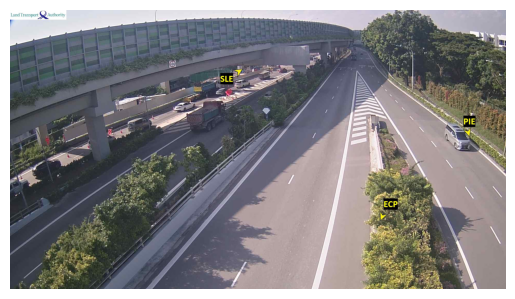

Running inference on: cam_7_20241021-135624.jpg

0: 384x640 4 Cars, 10.0ms
Speed: 10.7ms preprocess, 10.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


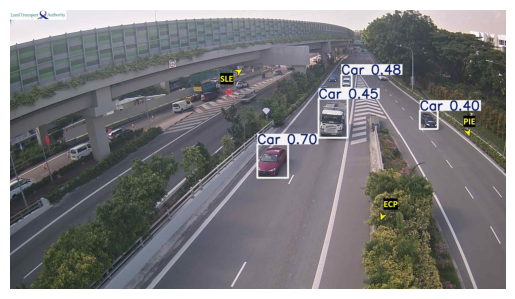

Running inference on: cam_7_20241021-135929.jpg

0: 384x640 4 Cars, 11.3ms
Speed: 4.3ms preprocess, 11.3ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)


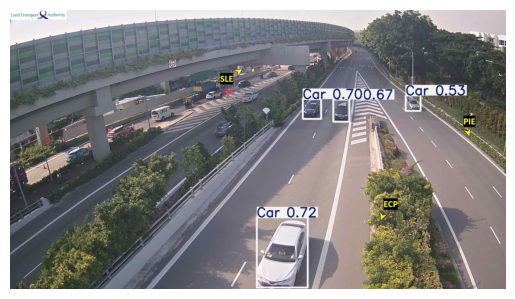

Running inference on: cam_7_20241021-140232.jpg

0: 384x640 (no detections), 1.0ms
Speed: 3.2ms preprocess, 1.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


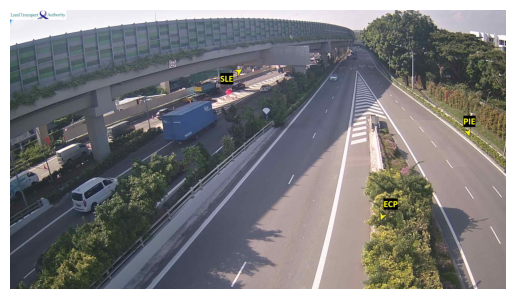

Running inference on: cam_7_20241021-140536.jpg

0: 384x640 2 Cars, 1 Multi-Axle, 0.0ms
Speed: 10.7ms preprocess, 0.0ms inference, 9.8ms postprocess per image at shape (1, 3, 384, 640)


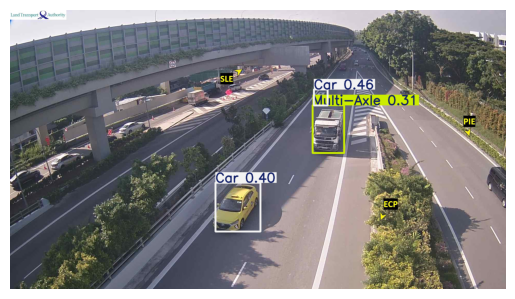

Cumulative Vehicle Type Counts:
Car: 126
Multi-Axle: 16
Motorcycle: 10
Truck: 2
Bus: 4
Total Inference Time: 67.0448648929596 seconds


In [13]:
from ultralytics import YOLO
import cv2
import os
import matplotlib.pyplot as plt
import seaborn as sns
import time

start = time.time()
image_dir = os.path.join(current_dir, 'traffic_images')

output_dir = os.path.join(current_dir, 'output')
os.makedirs(output_dir, exist_ok=True)

def run_inference_on_images(image_dir, model, output_dir):
    vehicle_counts = {}

    image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]

    for img_file in image_files:
        img_path = os.path.join(image_dir, img_file)
        print(f"Running inference on: {img_file}")
        img = cv2.imread(img_path)
        results = model.predict(img, save=False, conf=0.25)
        for result in results:
            for box in result.boxes:
                cls_id = int(box.cls)
                cls_name = model.names[cls_id]

                if cls_name in vehicle_counts:
                    vehicle_counts[cls_name] += 1
                else:
                    vehicle_counts[cls_name] = 1
        result_image_path = os.path.join(output_dir, img_file)
        result_image = results[0].plot()
        cv2.imwrite(result_image_path, result_image)


        plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()

    return vehicle_counts

vehicle_counts = run_inference_on_images(image_dir, model, output_dir)

print("Cumulative Vehicle Type Counts:")
for vehicle_type, count in vehicle_counts.items():
    print(f"{vehicle_type}: {count}")
end = time.time()
print(f"Total Inference Time: {end - start} seconds")


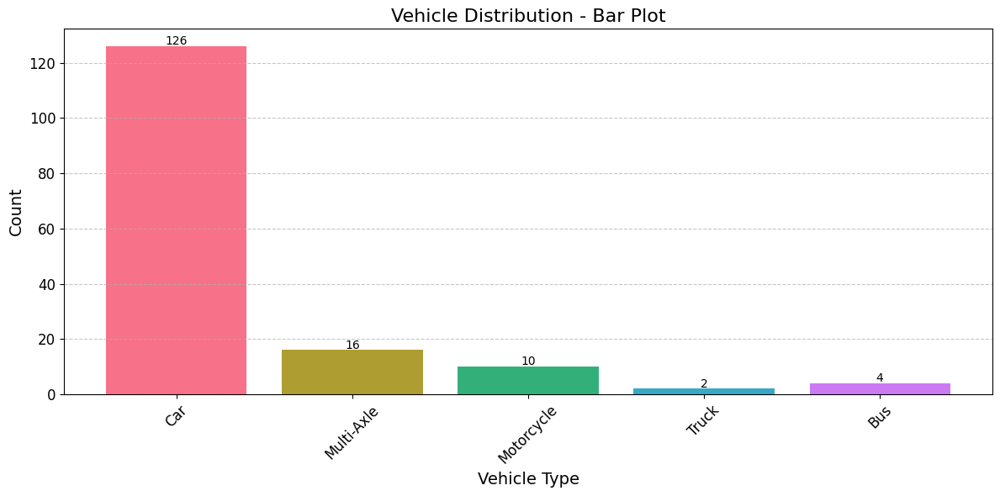

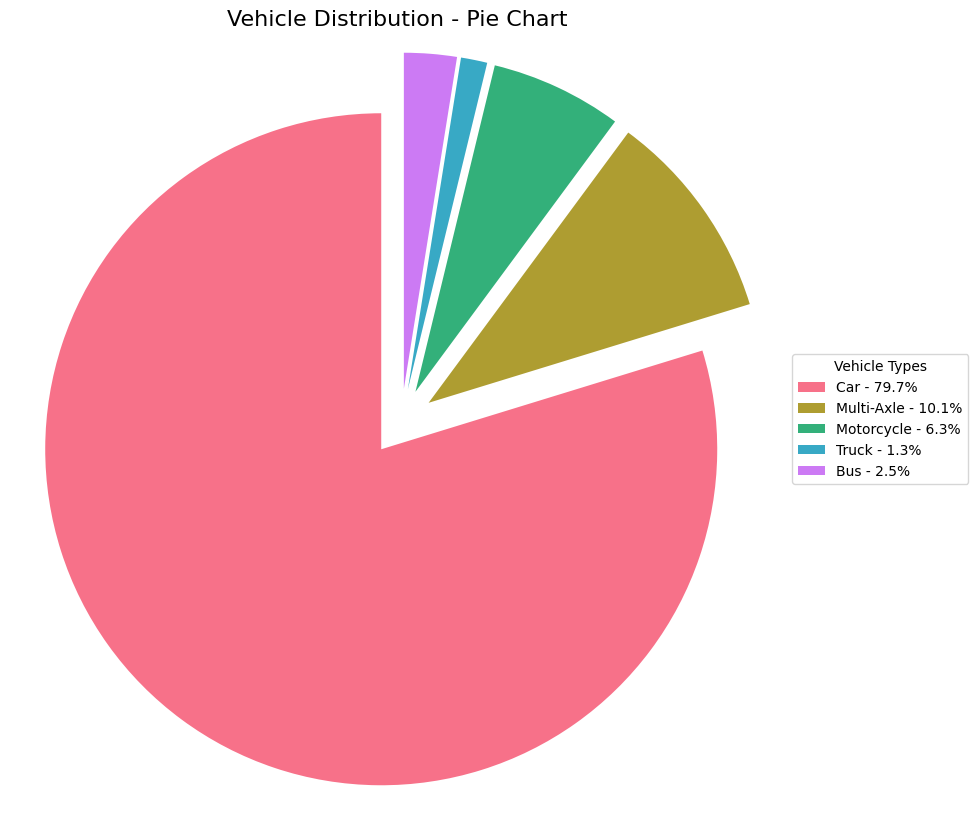

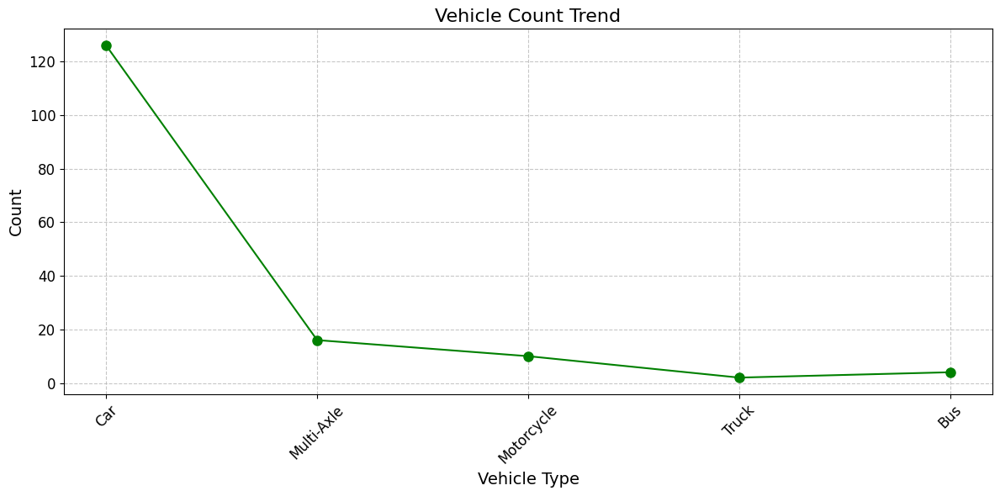

In [14]:
def visualize(vehicle_counts):
    vehicle_types = list(vehicle_counts.keys())
    counts = list(vehicle_counts.values())
    total_count = sum(counts)

    palette = sns.color_palette("husl", len(vehicle_types))

    plt.figure(figsize=(12, 6))
    bars = plt.bar(vehicle_types, counts, color=palette)
    plt.xlabel('Vehicle Type', fontsize=14)
    plt.ylabel('Count', fontsize=14)
    plt.title('Vehicle Distribution - Bar Plot', fontsize=16)
    plt.xticks(rotation=45, fontsize=12)
    plt.yticks(fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.7)

    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, yval + 0.5, int(yval), ha='center', fontsize=10)

    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(10, 10))
    wedges, autotexts = plt.pie(
        counts, labels=None, startangle=90, colors=palette, explode=[0.1]*len(vehicle_types)
    )

    plt.setp(autotexts, size=12, weight="bold", color="white")

    plt.title('Vehicle Distribution - Pie Chart', fontsize=16)
    plt.axis('equal')

    percentages = [f'{(count / total_count) * 100:.1f}%' for count in counts]

    legend_labels = [f"{vehicle} - {percentage}" for vehicle, percentage in zip(vehicle_types, percentages)]
    plt.legend(wedges, legend_labels, title="Vehicle Types", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
    plt.show()

    plt.figure(figsize=(12, 6))
    plt.plot(vehicle_types, counts, marker='o', linestyle='-', color='green', markersize=8)
    plt.xlabel('Vehicle Type', fontsize=14)
    plt.ylabel('Count', fontsize=14)
    plt.title('Vehicle Count Trend', fontsize=16)
    plt.xticks(rotation=45, fontsize=12)
    plt.yticks(fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

visualize(vehicle_counts)


In [ ]:
import shutil
shutil.make_archive(os.path.join(current_dir, 'output'), 'zip', os.path.join(current_dir))